## Explores Network Relationships:
Between popular/unpopular neighbourhoods, listing brokers, rental price, and customer sentiments in Seattle, Newyork and San Francisco using Network Graphs and Heatmap. 

Tries to explore the question, what might be the reason for business success? 

In [1]:
import pandas as pd
import numpy as np
import geopandas as gp
import pgeocode
import altair as alt
import matplotlib.pyplot as plt
%matplotlib inline
import networkx as nx
from tqdm import tqdm
tqdm.pandas()
from functools import lru_cache
from geopy.geocoders import Nominatim
from networkx.drawing.nx_pydot import graphviz_layout
import nx_altair as nxa
%config Completer.use_jedi = False                                 # patch required for my local machine
from collections import Counter
from operator import itemgetter
from nltk.util import flatten
import pandas_profiling 
import nx_altair as nxa

In [2]:
# enable correct rendering (unnecessary in later versions of Altair)
alt.renderers.enable('default')
# uses intermediate json files to speed things up
alt.data_transformers.enable('json')

DataTransformerRegistry.enable('json')

In [3]:
listings = pd.read_csv('../Dataset/Sanfrancisco/detailed_listings.csv')

In [4]:
# Any integer columns saved as an object: 
listings.select_dtypes(['object']).describe().columns
# Notice price column ('target') will require some cleaning
# Let's see price first:
listings['price']

0       $150.00
1       $195.00
2        $56.00
3        $56.00
4       $795.00
         ...   
6677    $135.00
6678     $55.00
6679    $188.00
6680    $126.00
6681    $120.00
Name: price, Length: 6682, dtype: object

In [6]:
import re
def build_network(file_listings, file_neighbourhoods, file_sentiments='sentiment_feature.pkl', source_column='neighbourhood_cleansed', target_column='host_name', popular_nodes= True): 
    """Returns a network graph of popular/unpopular nodes"""
    
    # Read and clean files:
    # read files: 
    df_lst = pd.read_csv('../Dataset/'+ file_listings)
    df_nei = pd.read_csv('../Dataset/'+ file_neighbourhoods)
    df_sent = pd.read_pickle('../Output/'+file_sentiments)

    #display(df_lst.head(2), df_nei.head(2))
    
    # convert file_neighbourhoods to a list: 
    lst_nei = df_nei['neighbourhood'].tolist()
    
    # filter file_listings by file_neighbourhoods: 
    df_listings_filter = df_lst[df_lst['neighbourhood_cleansed'].isin(lst_nei)].dropna(how='all')
    
    # merge customer sentiments:
    # groupby sentiments 
    df_sent_grp = df_sent.groupby('listing_id').agg({'compound':'mean'}).reset_index()
    df_filter = pd.merge(left = df_listings_filter, right = df_sent_grp, left_on = 'id', right_on = 'listing_id', how = 'inner').drop('listing_id', axis = 1)
    
    # clean and convert price column to float:
    df_filter['price'] = pd.to_numeric(df_filter['price'].str.split("$").str.get(1).progress_apply(lambda x: x.replace(',', '')))
    
    # Remove and, &, And, non-alphanumeric characters from host_name:
    df_filter['host_name'] = (df_filter['host_name']
                              .apply(lambda a: re.sub('(&)', ',', str(a)))
                              .apply(lambda b: re.sub('(and)',',', str(b)))
                              .apply(lambda c: re.sub('(And)',',', str(c)))
                              .apply(lambda d: re.sub('[\W+]',' ',str(d)))
                              .apply(lambda e: ' '.join([str(i) for i in e.split()])))
    
    
    # Build Network Graph: 
    G = nx.from_pandas_edgelist(df_filter, source=source_column, target=target_column, edge_attr= True)
    
    # Get unique nodes: 
    # source & target: 
    source_lsts = list(df_filter[source_column].unique())
    target_lsts = list(df_filter[target_column].unique())
    
    # Get node size:
    # source &  target
    source_size =  [G.degree(item)*60 for item in source_lsts]
    target_size = [G.degree(item)*60 for item in target_lsts]
     
    # Get top 5 nodes with highest degree:
    # source and target:
    top_5_sources = sorted([G.degree(item) for item in source_lsts], reverse = True)[:5][-1]
    top_5_targets = sorted([G.degree(item) for item in target_lsts], reverse = True)[:5][-1]
    
    low_5_sources = sorted([G.degree(item) for item in source_lsts], reverse = False)[:5][-1]
    low_5_targets = sorted([G.degree(item) for item in target_lsts], reverse = False)[:5][-1]
        
    # Plot Network:    
    _ = plt.figure(figsize=(27,27)) 
    _ = plt.title(f'Network Graph: {file_listings}\nPopular Nodes: {popular_nodes}', fontsize = 20)
    
    # layout:
    layout = nx.spring_layout(G, iterations=50, k= 0.1)
    
    # Draw Edges: 
    nx.draw_networkx_edges(G, layout, width=1, edge_color="lightgray")
    
    # Draw Target Nodes: 
    nx.draw_networkx_nodes(G, layout, nodelist=target_lsts, node_size= target_size, node_color='lightblue', edgecolors= 'gray')
    
    # Draw Source Nodes:
    nx.draw_networkx_nodes(G, layout, nodelist=source_lsts, node_size=source_size, node_color='gainsboro', edgecolors= 'gray')
    
    # Draw Popular Nodes:
    # filter popular nodes:
    if popular_nodes: 
        popular_sources = [item for item in source_lsts if G.degree(item)>=top_5_sources]
        popular_targets = [item for item in target_lsts if G.degree(item)>=top_5_targets]
        
        # draw popular source and target nodes:
        nx.draw_networkx_nodes(G, layout, nodelist=popular_sources, node_color='salmon', node_size=300, node_shape='D', label = f'Source: {source_column}')
        nx.draw_networkx_nodes(G, layout, nodelist=popular_targets, node_color='red', node_size=300, node_shape='D', label = f'Target: {target_column}')

        # Label nodes: 
        source_node_labels = dict(zip(popular_sources, popular_sources))
        target_node_labels = dict(zip(popular_targets, popular_targets))
        nx.draw_networkx_labels(G, layout, labels=source_node_labels, font_size= 9, horizontalalignment='left', verticalalignment= 'bottom')
        nx.draw_networkx_labels(G, layout, labels=target_node_labels, font_size= 9, horizontalalignment='right', verticalalignment = 'top')

        # 4. Turn off the axis 
        _ = plt.axis('off')
        _ = plt.legend(fontsize = 15)
        _ = plt.show()
    
    else: 
        unpopular_sources = [item for item in source_lsts if G.degree(item)<=low_5_sources]
        unpopular_targets = [item for item in target_lsts if ((G.degree(item)>low_5_targets+3) & (G.degree(item)<(low_5_targets)+5))]
        

        # draw popular source and target nodes:
        nx.draw_networkx_nodes(G, layout, nodelist=unpopular_sources, node_color='lightsalmon', node_size=300, node_shape='D', label = f'Source: {source_column}')
        nx.draw_networkx_nodes(G, layout, nodelist=unpopular_targets, node_color='mistyrose', node_size=300, node_shape='D', label = f'Target: {target_column}')

        # Label nodes: 
        source_node_labels_2 = dict(zip(unpopular_sources, unpopular_sources))
        target_node_labels_2 = dict(zip(unpopular_targets, unpopular_targets))
        nx.draw_networkx_labels(G, layout, labels=source_node_labels_2, font_size= 9, horizontalalignment='left', verticalalignment= 'bottom')
        nx.draw_networkx_labels(G, layout, labels=target_node_labels_2, font_size= 9, horizontalalignment='right', verticalalignment = 'top')

        # 4. Turn off the axis 
        _ = plt.axis('off')
        _ = plt.legend(fontsize = 15)
        _ = plt.show()
    return G
        

### 1. Relationship between Neighborhood and Host

#### 1. Seattle, Newyork, San Francisco: 

100%|██████████| 3333/3333 [00:00<00:00, 895039.07it/s]


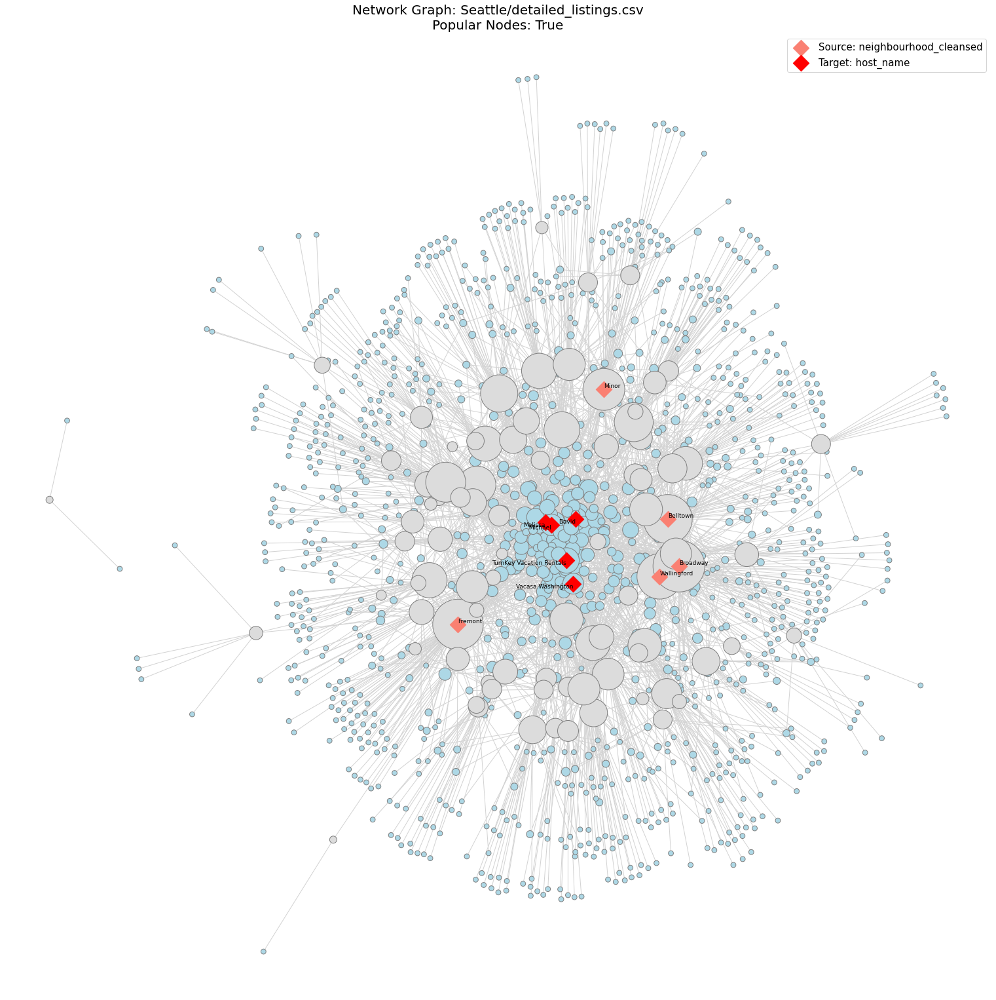

100%|██████████| 26772/26772 [00:00<00:00, 928744.94it/s]


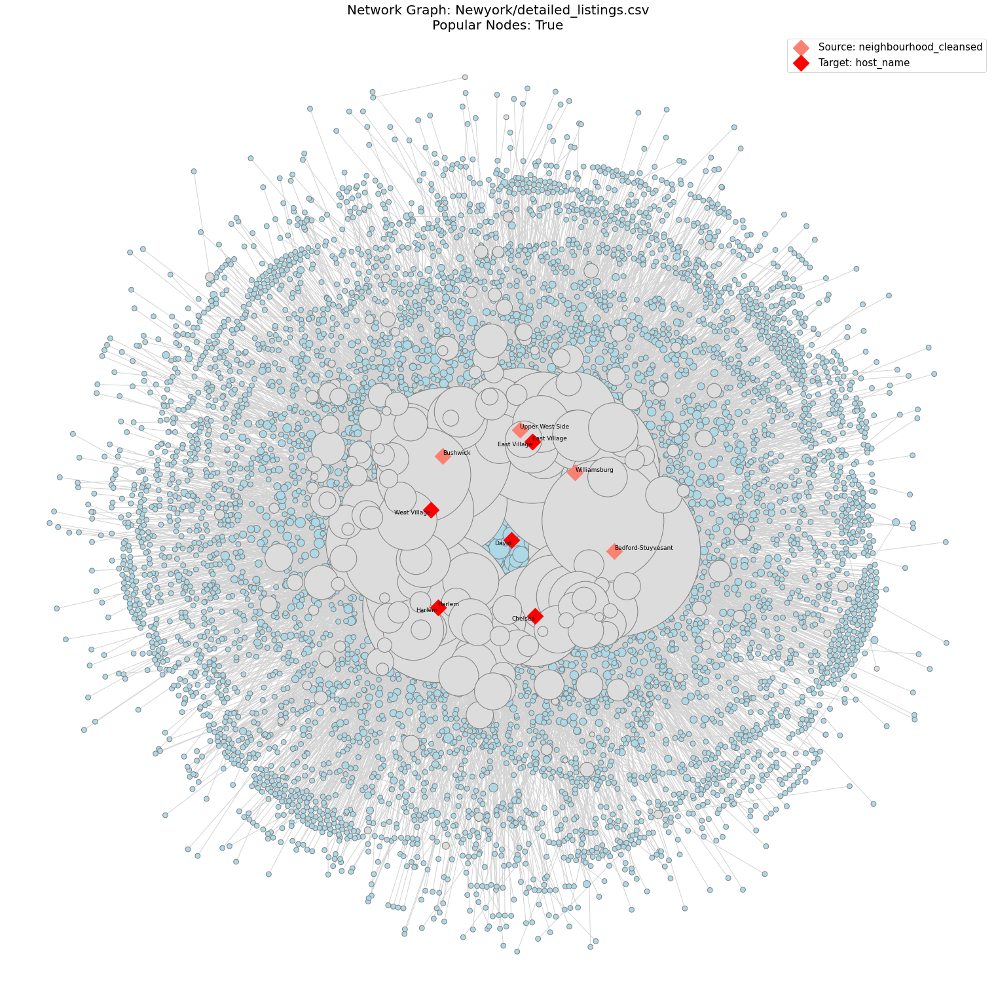

100%|██████████| 5010/5010 [00:00<00:00, 979100.88it/s]


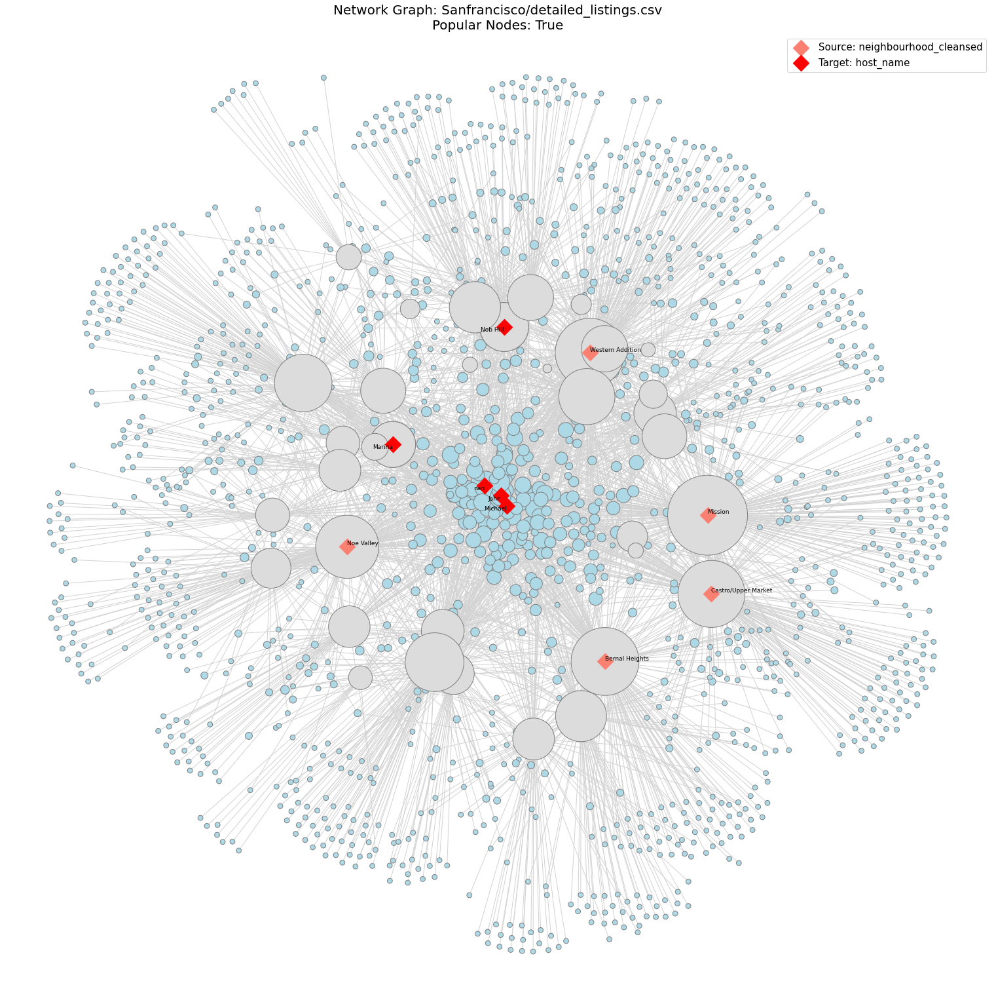

CPU times: user 3min, sys: 3.45 s, total: 3min 3s
Wall time: 2min 44s


In [7]:
%%time 
G_host_sea = build_network('Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='host_name', popular_nodes= True)
G_host_new = build_network('Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='host_name', popular_nodes= True)
G_host_san = build_network('Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='host_name', popular_nodes= True)

# Assign name to the network: 
G_host_sea.name = 'Host_Names in Seattle'
G_host_new.name = 'Host_Names in Newyork'
G_host_san.name = 'Host_Names in Sanfrancisco'

### Hosts on shortest path in San Francisco ?

In [8]:
print(nx.shortest_path(G_host_san, 'Mission', 'David'))
print(nx.shortest_path(G_host_san, 'Crocker Amazon', 'David'))

['Mission', 'David']
['Crocker Amazon', 'Annie', 'Twin Peaks', 'David']


### Average shortest path of connected hosts in San Francisco?

In [9]:
largest_component = max(nx.connected_components(G_host_san), key = len)

print(nx.average_shortest_path_length(G_host_san.subgraph(largest_component)))

3.7117654621380582


### Relationship between Neighborhood and Price

100%|██████████| 3333/3333 [00:00<00:00, 921469.60it/s]


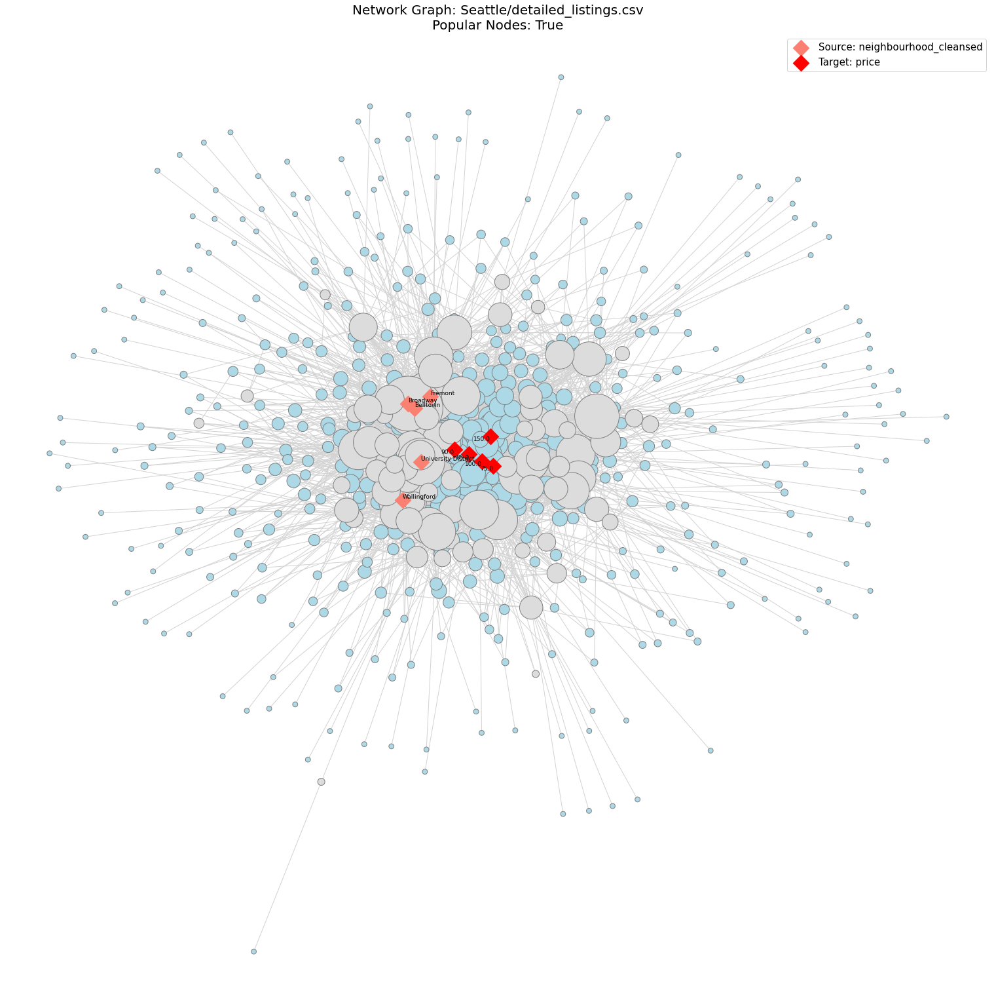

100%|██████████| 26772/26772 [00:00<00:00, 1026735.06it/s]


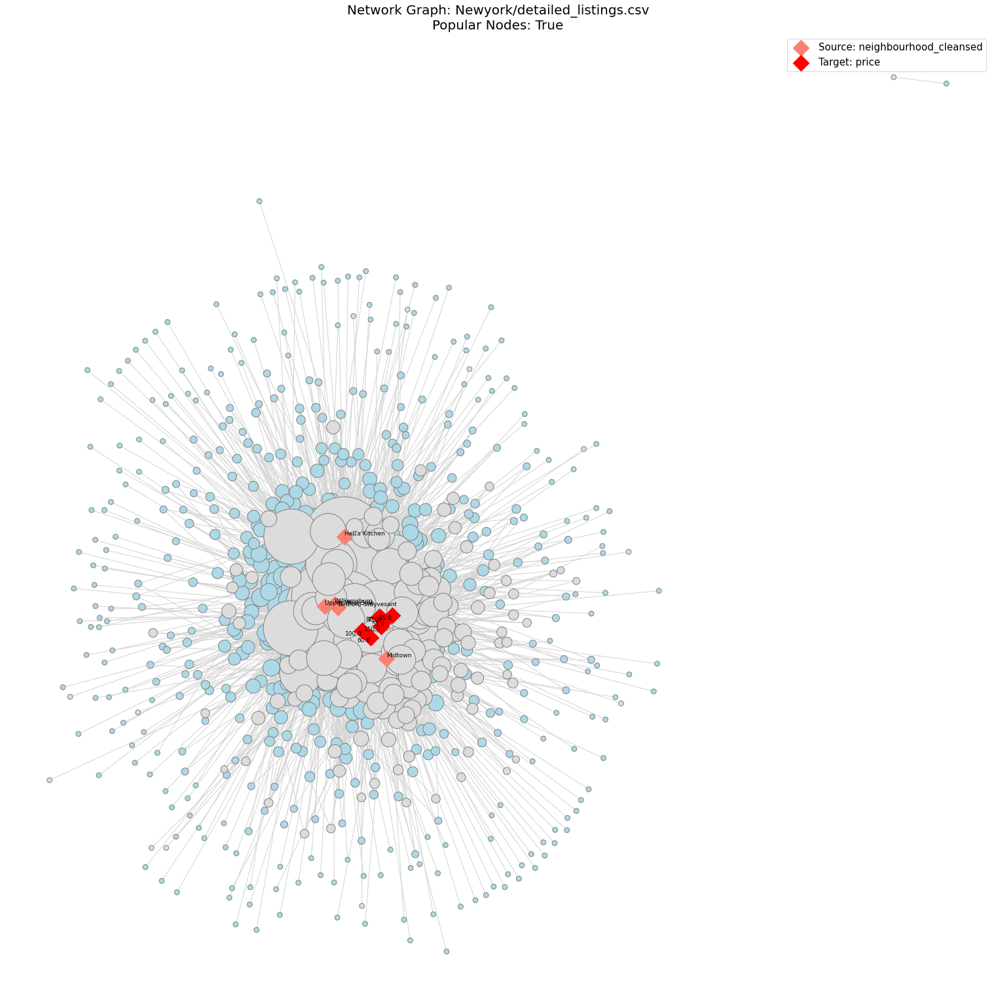

100%|██████████| 5010/5010 [00:00<00:00, 991668.86it/s]


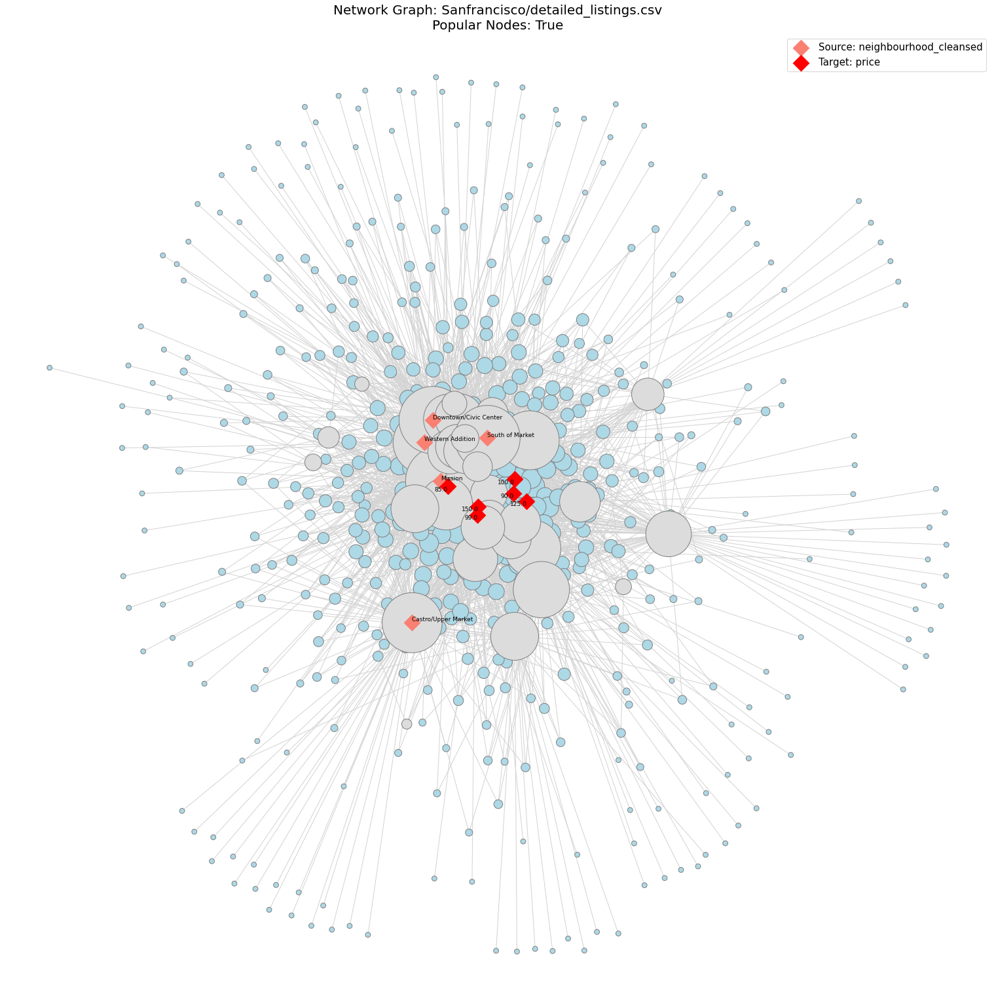

CPU times: user 16.8 s, sys: 1.13 s, total: 17.9 s
Wall time: 18 s


In [10]:
%%time 
G_price_sea = build_network('Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='price', popular_nodes= True)
G_price_new = build_network('Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='price', popular_nodes= True)
G_price_san = build_network('Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='price', popular_nodes= True)

# Assign name to the network: 
G_price_sea.name = 'Prices in Seattle'
G_price_new.name = 'Prices in Newyork'
G_price_san.name = 'Prices in Sanfrancisco'

### Relationship between Neighborhood and Rental Availability

100%|██████████| 3333/3333 [00:00<00:00, 955740.43it/s]


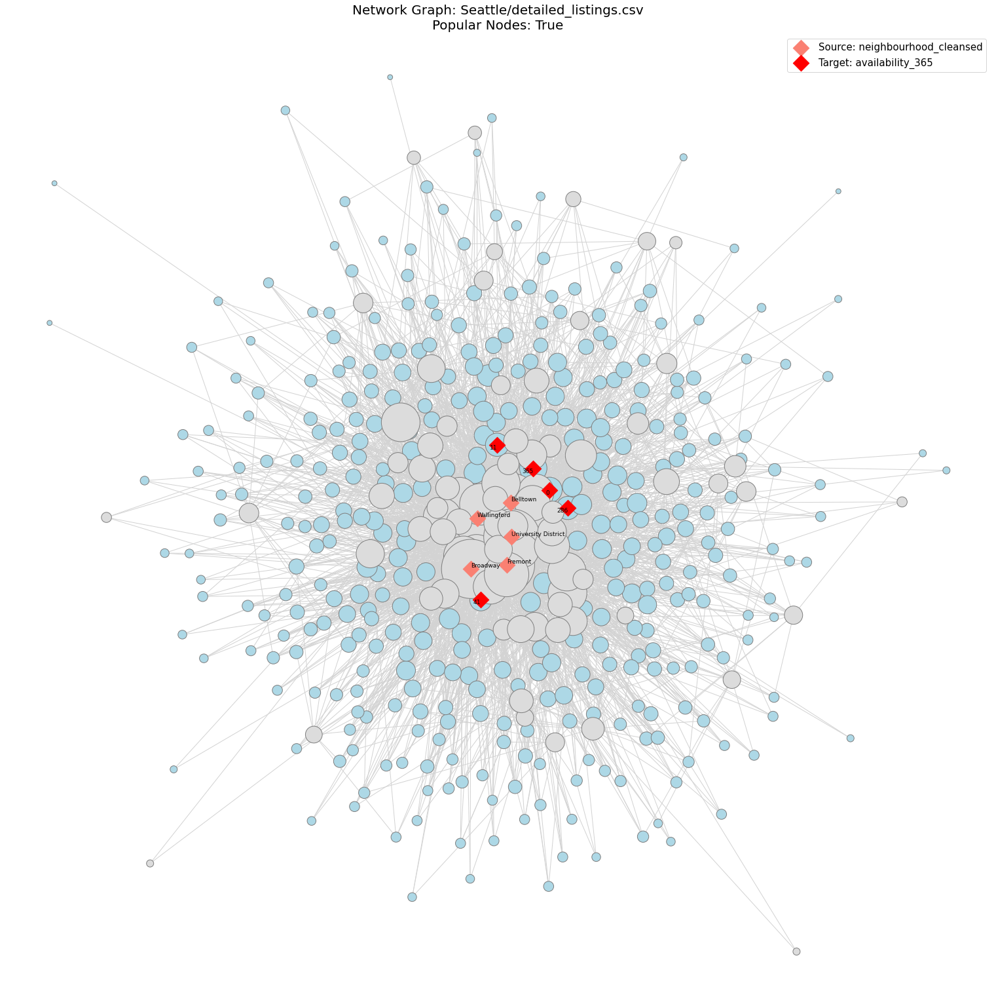

100%|██████████| 26772/26772 [00:00<00:00, 962498.66it/s]


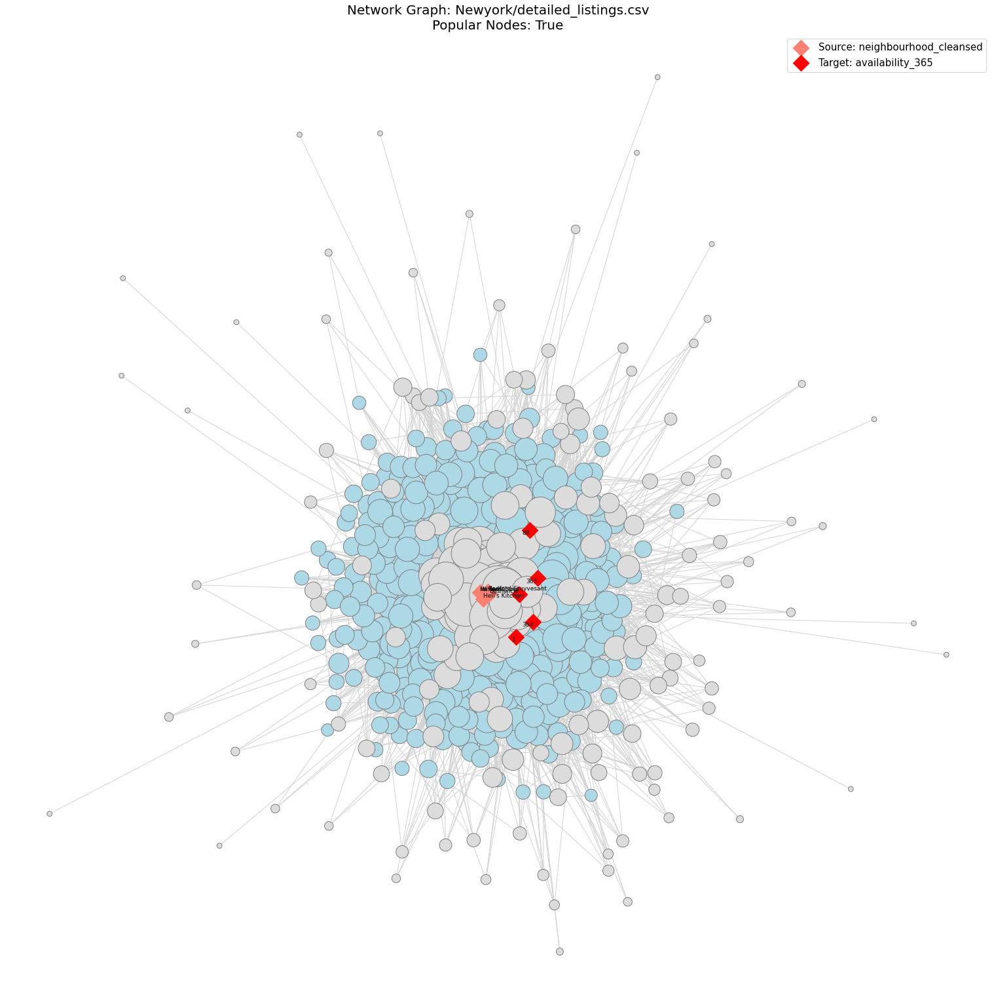

100%|██████████| 5010/5010 [00:00<00:00, 958862.11it/s]


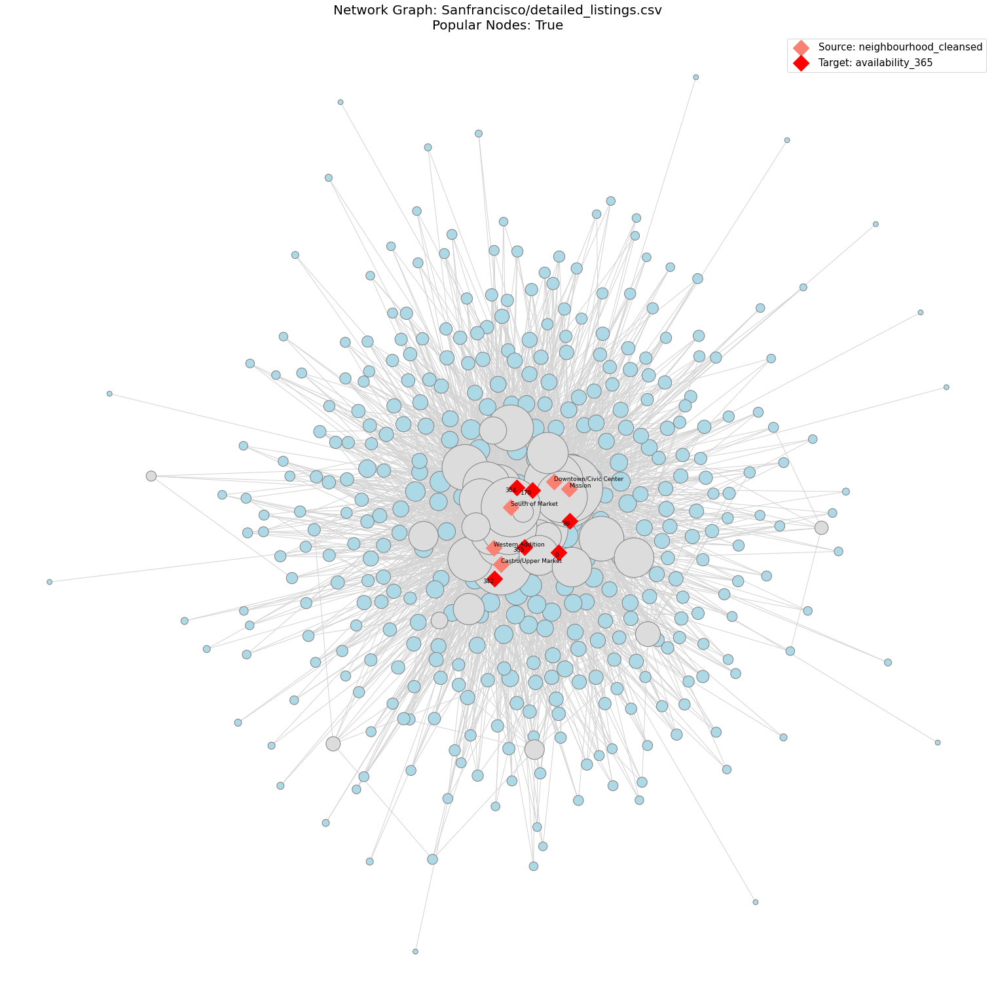

CPU times: user 11.4 s, sys: 1.05 s, total: 12.4 s
Wall time: 12.4 s


In [11]:
%%time 
G_availability_sea = build_network('Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='availability_365', popular_nodes= True)
G_availability_new = build_network('Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='availability_365', popular_nodes= True)
G_availability_san = build_network('Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='availability_365', popular_nodes= True)

# Assign name to the network: 
G_availability_sea.name = 'Availability in Seattle'
G_availability_new.name = 'Availability in Newyork'
G_availability_san.name = 'Availability in Sanfrancisco'

### Relationship between Neighborhood and Customer Sentiments:

100%|██████████| 3333/3333 [00:00<00:00, 920741.30it/s]


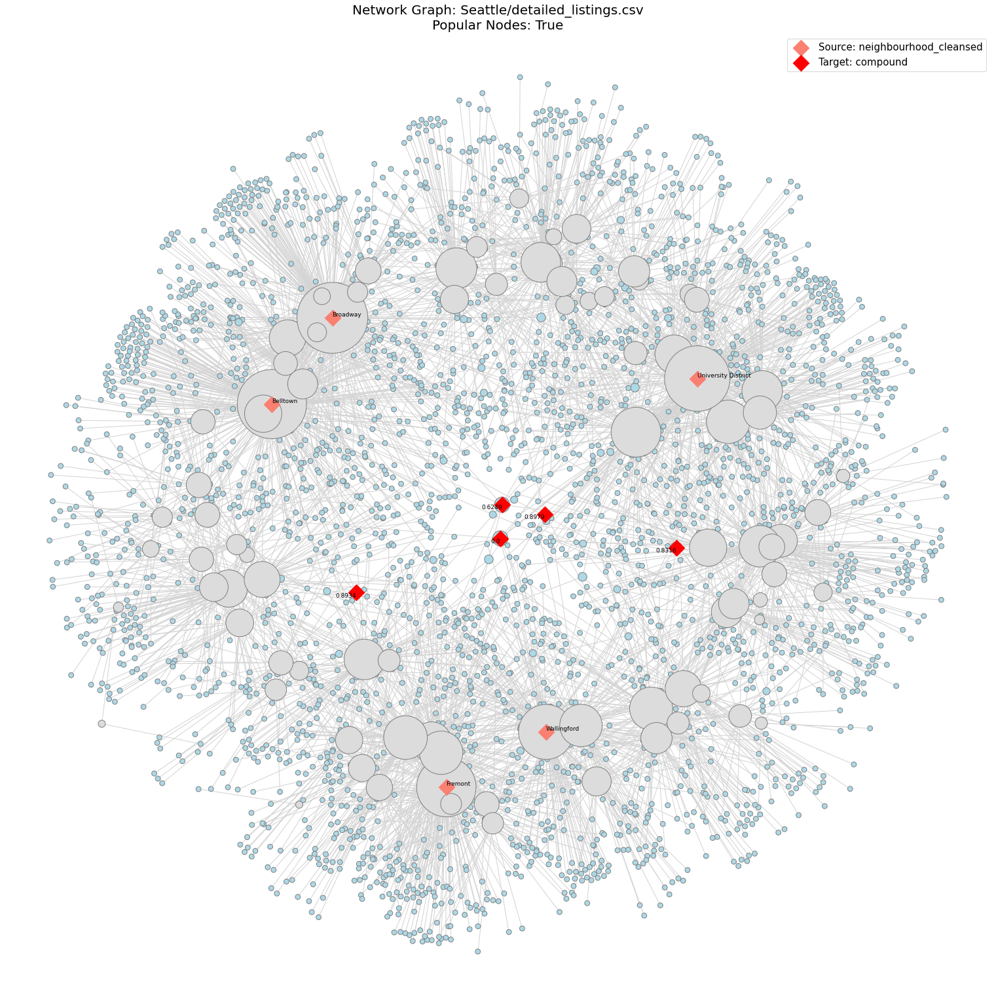

100%|██████████| 26772/26772 [00:00<00:00, 890680.78it/s]


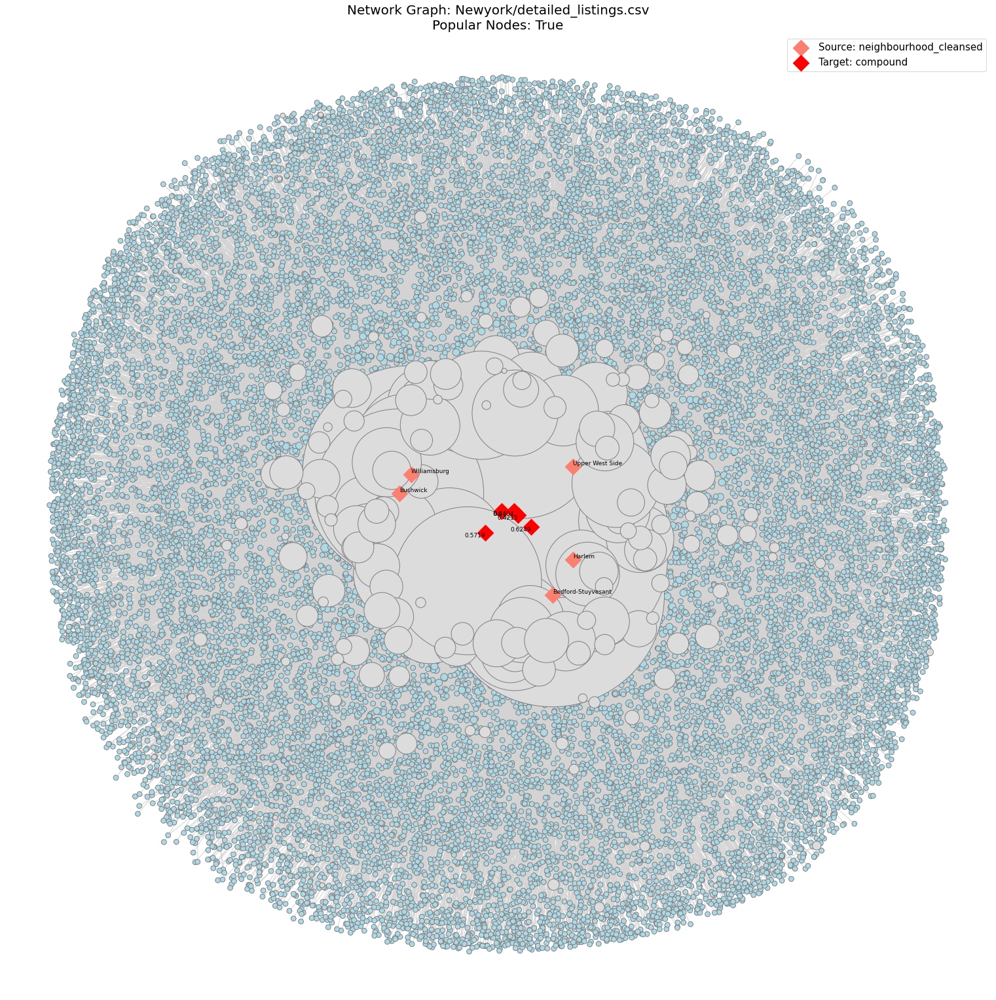

100%|██████████| 5010/5010 [00:00<00:00, 962154.90it/s]


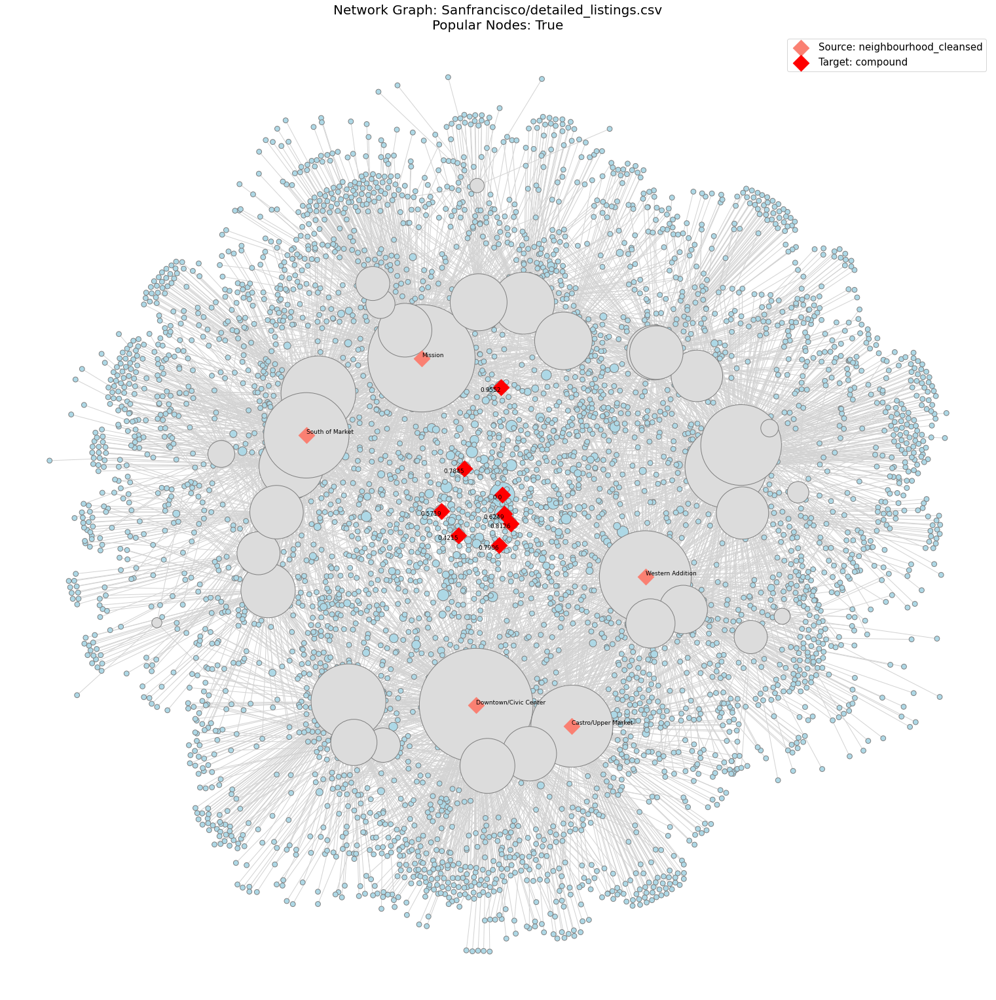

CPU times: user 18min, sys: 7.01 s, total: 18min 7s
Wall time: 17min 7s


In [12]:
%%time 
G_sentiments_sea = build_network('Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='compound', popular_nodes= True)
G_sentiments_new = build_network('Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='compound', popular_nodes= True)
G_sentiments_san = build_network('Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='compound', popular_nodes= True)

# Assign name to the network: 
G_sentiments_sea.name = 'Sentiments in Seattle'
G_sentiments_new.name = 'Sentiments in Newyork'
G_sentiments_san.name = 'Sentiments in Sanfrancisco'

### Centrality Measures

In [13]:
### Functions Centrality Measures:

def degree_centrality(G, top_n, popular= True): 
    """Returns degree centrality of popular and non-popular nodes"""
    
    # Centrality measure between Neighborhood and Host:
    deg_centrality = nx.degree_centrality(G)
    
    if popular:
        # Sorted in Descending Order: 
        df = pd.DataFrame(sorted(deg_centrality.items(), key = itemgetter(1), reverse = True)[:top_n], columns = ['Node', 'Degree Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    else: 
        df = pd.DataFrame(sorted(deg_centrality.items(), key = itemgetter(1), reverse = False)[:top_n], columns = ['Node', 'Degree Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    
    return df




def closeness_centrality(G, top_n, popular= True): 
    """Returns closeness centrality of popular and non-popular nodes"""
        
    # Centrality measure between Neighborhood and Host:
    close_centrality = nx.closeness_centrality(G)
    
    if popular:
        # Sorted in Descending Order:  
        df = pd.DataFrame(sorted(close_centrality.items(), key = itemgetter(1), reverse = True)[:top_n], columns = ['Node', 'Closeness Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    else: 
        df = pd.DataFrame(sorted(close_centrality.items(), key = itemgetter(1), reverse = False)[:top_n], columns = ['Node', 'Closeness Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    
    return df



def betweenness_centrality(G, top_n, popular= True): 
    """Returns betweenness centrality of popular and non-popular nodes"""
        
    # Centrality measure between Neighborhood and Host:
    between_centrality = nx.betweenness_centrality(G)
    
    if popular:    
        # Sorted in Descending Order: 
        df = pd.DataFrame(sorted(between_centrality.items(), key = itemgetter(1), reverse = True)[:top_n], columns = ['Node', 'Betweenness Centrality'], )
        df['Node'] = df['Node'].apply(lambda x: str(x))
    else: 
        df = pd.DataFrame(sorted(between_centrality.items(), key = itemgetter(1), reverse = False)[:top_n], columns = ['Node', 'Betweenness Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    
    return df

        
        
def result_centrality_measures(G, top_n, popular= True):
    """Returns 3 centrality measures of popular and non-popular nodes"""
    
    df_concat = pd.concat([degree_centrality(G, top_n, popular= popular),
                           closeness_centrality(G, top_n, popular= popular),
                           betweenness_centrality(G, top_n, popular= popular)])
    return pd.melt(id_vars='Node',
                   var_name='Centrality Measure',
                   value_name = 'Score',
                   frame = df_concat).dropna(how= 'any')



def plot_centrality_measure(G, top_n, popular=True): 
    """Returns a heat map of 3 centrality measures of popular and non-popular nodes"""    
    
    df = result_centrality_measures(G, top_n, popular=popular)
    
    nodes = df.sort_values(by = 'Score', ascending = False)
    sort_nodes = nodes['Node'].tolist()
    
    # plot chart: 
    line = (alt.Chart(df)
            .mark_line()
            .encode(x= alt.X('Node:N'),
                    y = alt.Y('Score:Q'),
                    color = alt.Color('Centrality Measure:N',legend = None))
            .transform_filter(alt.datum.Node!='nan'))
    
    line_points = (alt.Chart(df)
                   .mark_circle(size = 100)
                   .encode(x= alt.X('Node:N'),
                           y = alt.Y('Score:Q'), 
                           color = 'Centrality Measure:N',
                           size = alt.Size('Score:Q', scale = alt.Scale(range = (0,300))),
                   tooltip = ['Node:N', 'Centrality Measure:N', 'Score:Q'])
                   .transform_filter(alt.datum.Node!='nan'))
    
    rect = (alt.Chart(df)
            .mark_rect()
            .encode(x= alt.X('Centrality Measure:N'),
                    y = alt.Y('Node:N', sort =sort_nodes),
                    color = alt.Color('Score:Q'),
                    tooltip = ['Node:N', 'Centrality Measure:N', 'Score:Q'])
            .transform_filter(alt.datum.Node!='nan'))
    
    rect_circle = (alt.Chart(df)
              .mark_circle()
              .encode(x= alt.X('Centrality Measure:N'),
                      y = alt.Y('Node:N', sort = sort_nodes), 
                      size = alt.Size('Score:Q', scale = alt.Scale(range = (0,200))),
                      color = alt.Color('Score:Q', scale = alt.Scale(scheme = 'greys'), legend=None),
                      tooltip = ['Node:N', 'Centrality Measure:N', 'Score:Q'])
              .transform_filter(alt.datum.Node!='nan'))
    
    heatmap = (rect+rect_circle).resolve_scale(color='independent').properties(width = 300, height = 500)
    line_chart =(line+line_points).resolve_scale(color='independent').properties(width = 300, height = 500)

    
    return (heatmap|line_chart).properties(title = [f'Centrality Measure of top {top_n} nodes for {G.name}', f'Popular Nodes: {popular}'])


In [14]:
%%time
# Closeness Centrality: Helps spread information quickly
(plot_centrality_measure(G_host_sea, 10 , popular=True) 
 & plot_centrality_measure(G_host_new, 10 , popular=True) 
 & plot_centrality_measure(G_host_san, 10 , popular=True)) 

CPU times: user 6min 13s, sys: 2.33 s, total: 6min 16s
Wall time: 6min 16s


alt.VConcatChart(...)

In [15]:
#Uncomment this to see popular prices in Seattle Area
plot_centrality_measure(G_price_sea, 10 , popular=True)

alt.HConcatChart(...)

### Add Closesness Centrality as Network Feature: 

In [16]:
def add_centrality_measure(G, file_listings, file_neighbourhoods, file_sentiments = 'sentiment_feature.pkl'):
    
    """Returns dataframe with edge betweenness and closeness centrality """
    
    # Read and clean files:
    # read files: 
    df_lst = pd.read_csv('../Dataset/'+file_listings)
    df_nei = pd.read_csv('../Dataset/'+file_neighbourhoods)
    df_sent = pd.read_pickle('../Output/'+file_sentiments)
   
    #display(df_lst.head(2), df_nei.head(2))
    
    # convert file_neighbourhoods to a list: 
    lst_nei = df_nei['neighbourhood'].tolist()
    
    # filter file_listings by file_neighbourhoods: 
    df_listings_filter = df_lst[df_lst['neighbourhood_cleansed'].isin(lst_nei)].dropna(how='all')
    
    # merge customer sentiments:
    # groupby sentiments 
    df_sent_grp = df_sent.groupby('listing_id').agg({'compound':'mean'}).reset_index()
    df_filter = pd.merge(left = df_listings_filter, right = df_sent_grp, left_on = 'id', right_on = 'listing_id', how = 'inner').drop('listing_id', axis = 1)
    
    
    # clean and convert price column to float:
    df_filter['price'] = pd.to_numeric(df_filter['price'].str.split("$").str.get(1).progress_apply(lambda x: x.replace(',', '')))
    
    # replace and, &, And, + in host_name with commma:
    df_filter['host_name'] = (df_filter['host_name']
                              .apply(lambda a: re.sub('(&)', ',', str(a)))
                              .apply(lambda b: re.sub('(and)',',', str(b)))
                              .apply(lambda c: re.sub('(And)',',', str(c)))
                              .apply(lambda d: re.sub('[\W+]',' ',str(d)))
                              .apply(lambda e: ' '.join([str(i) for i in e.split()])))
    
    
    df_filter['node_edge']  = list(zip(df_filter['neighbourhood_cleansed'], df_filter['host_name']))
    
    edge_betweenness = nx.edge_betweenness_centrality(G)
    
    close_centrality = {i: nx.closeness_centrality(G, u = i[1]) for i in G.edges()}
    
    df_filter['edge_betweenness_host'] = df_filter['node_edge'].map(edge_betweenness)
    
    df_filter['closeness_centrality_host'] = df_filter['node_edge'].map(close_centrality)
   
    return df_filter

In [17]:
%%time
# Get centrality features for each city
network_feature_sea = add_centrality_measure( G_host_sea,'Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv')
network_feature_new = add_centrality_measure(G_host_new,'Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv')
network_feature_san = add_centrality_measure(G_host_san, 'Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv')

100%|██████████| 5010/5010 [00:00<00:00, 998833.68it/s]


CPU times: user 8min 42s, sys: 1.61 s, total: 8min 43s
Wall time: 8min 45s


In [18]:
# Add location name to each listing
network_feature_sea['location']= 'seattle'
network_feature_new['location'] = 'newyork'
network_feature_san['location'] = 'sanfrancisco'

# Concat dataframe: 
df_network_feature = pd.concat([network_feature_sea, network_feature_new, network_feature_san], axis= 0, ignore_index=True)

# Save network_feature in output folder
df_network_feature.to_pickle('../Output/network_feature.pkl')

In [19]:
df_network_feature.head(3)

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,compound,node_edge,edge_betweenness_host,closeness_centrality_host,location
0,2318,https://www.airbnb.com/rooms/2318,20210714194849,2021-07-14,Casa Madrona - Urban Oasis 1 block from the park!,"Gorgeous, architect remodeled, Dutch Colonial ...",Madrona is a hidden gem of a neighborhood. It ...,https://a0.muscache.com/pictures/02973ad3-a7a3...,2536,https://www.airbnb.com/users/show/2536,...,2,2,0,0,0.58,0.880916,"(Madrona, Megan)",0.002049,0.281960,seattle
1,6606,https://www.airbnb.com/rooms/6606,20210714194849,2021-07-14,"Fab, private seattle urban cottage!","This tiny cottage is only 15x10, but it has ev...","A peaceful yet highly accessible neighborhood,...",https://a0.muscache.com/pictures/45742/21116d7...,14942,https://www.airbnb.com/users/show/14942,...,1,1,0,0,2.45,0.830917,"(Wallingford, Joyce)",0.001670,0.265394,seattle
2,9419,https://www.airbnb.com/rooms/9419,20210714194849,2021-07-14,Glorious sun room w/ memory foambed,"Keeping you safe is our priority, we are adher...","Lots of restaurants (see our guide book) bars,...",https://a0.muscache.com/pictures/56645186/e5fb...,30559,https://www.airbnb.com/users/show/30559,...,9,0,9,0,1.12,0.894111,"(Georgetown, Angielena)",0.000753,0.230757,seattle


### Relationship edge betweenness vs closeness centrality

In [20]:
def heatmap_network(df):
    
    """Returns a scatterplot between edge_betweenness and Closeness Centrality"""

    # unique locations:
    city = list(df['location'].unique())
    select = alt.selection_single(fields = ['location'], 
                                    init= {'location': city[0]},
                                    bind = alt.binding_radio(options = city, name= 'Select City'))


    closeness = (alt.Chart(df_network_feature)
                 .mark_bar()
                 .encode(y = alt.Y('closeness_centrality_host:Q'),
                         x= alt.X('location:N', axis = alt.Axis(title= "")),
                         color = alt.Color('location:N', scale=alt.Scale(scheme='viridis')),
                         tooltip = ['location:N', 'closeness_centrality_host:Q'])
                 .properties(width = 300, height = 400, title='Closeness Centrality Host')
                 .add_selection(select)
                   .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                           opacity = alt.condition(select, alt.value(1), alt.value(0.5))))

    edge_btw = (alt.Chart(df_network_feature)
                .mark_bar()
                .encode(y = alt.Y('edge_betweenness_host:Q'),
                        x= alt.X('location:N', axis = alt.Axis(title= "")), 
                        color = alt.Color('location:N', scale=alt.Scale(scheme='viridis')), 
                        tooltip = ['location:N', 'edge_betweenness_host:Q'])
                .properties(width = 300, height = 400, title='Edge Betweenness Host')
                .add_selection(select)
                   .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                           opacity = alt.condition(select, alt.value(1), alt.value(0.5))))

    edge_close = (alt.Chart(df_network_feature)
                  .mark_circle()
                  .encode(y = alt.Y('closeness_centrality_host:Q'),
                          x= alt.X('edge_betweenness_host:Q'),
                          color = alt.Color('location:N', scale=alt.Scale(scheme='viridis')), 
                          tooltip = ['location:N', 'closeness_centrality_host:Q', 'edge_betweenness_host:Q' ])
                  .properties(width = 700, height = 400, title='Edge Betweenness & Closeness Centrality')
                  .add_selection(select)
                   .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                           opacity = alt.condition(select, alt.value(1), alt.value(0.5))))


    return (((closeness|edge_btw) & edge_close)
     .configure_view(strokeWidth =0)
     .configure(background = '#f0f0f0')
     .configure_view(strokeWidth =0)
     .configure_axis(grid = True)
     .resolve_scale(color='independent'))


In [21]:
heatmap_network(df_network_feature)

alt.VConcatChart(...)

### Observations: 

1. Shortest_path between neighbourhoods and popular hosts can be useful to run marketing campaigns in less popular neighbourhoods. 
2. As price increases, number of degree nodes between popular neighbourhoods and price also decreases.
3. Some neighbourhoods (popular vs upcoming) show high availability (>300 days). This could be due to high variance in rental pricing and length of stay.
(Example: Downtown area may see daily commuters more often than community based rentals. So, higher price community rentals will likely have higher availability) 
4. Heatmap can be used to view centrality measures and filter network by price, availability, customer sentiments and so on. 
5. Realtionship between individual vs community brokers showed mixed customer sentiments.
(Example, individual brokers who had fewer (1 to 4) listings showed high positive sentiments. Also, few property managers (between 100 to 300 listings) showed high positive sentiments when compared to property managers with more listings.)   
6. Above can be useful in exploring neighbourhoods or brokers with lower customer sentiments for empowerment. 
5. Edge Centrality and Closeness Centrality shows linearly positive correlation for all 3 cities. This could mean that AirBnB might be using community brokers or superhosts to build highly close knit neighbourhoods in these areas. 
